<img src="san-francisco.jpg" alt="Drawing" style="width: 700px;"/>
<center>
<h1 style="font-size:36px;">San Francisco Crime Data Analysis</h1>
<h4> Erkai Zhang</h4>
<hr>
<h1>Introduction</h1>
</center>
<body><p>
San Francisco is a place many people's dream place to work at and live in. But with rising wealth inequality and housing shortages, there is no scarcity of crime in the city by the bay. Thus the questions are being asked: What types of crimes happened the most and where and when do they happen most often? How does public safety varies from place to place? So in this tutorial, we will analyze crime data from 1/1/2003 to 5/13/2015 and answer the question above and hopefully you could have a better idea about San Francisco crime activities and public safety from our analysis.  
<p> 
In this tutorial, we will first prepare, analyze, and visualize the crime data. Then we could interpret the data and make conclusion. 
<hr>
<center><h1>Getting Started</h1></center>
<body><p>
We will be using Python 3 in <a href = "https://jupyter.org">Jupyter Notebook</a> along with a few imported libraries: <a href="https://pandas.pydata.org/pandas-docs/stable/">pandas</a>, <a href="https://docs.scipy.org/doc/numpy/user/">numpy</a>, <a href="https://matplotlib.org/contents.html">matplotlib</a>, <a href="http://scikit-learn.org/stable/documentation.html">scikit-learn</a>, <a href="https://seaborn.pydata.org/">seaborn</a>, <a href = https://python-visualization.github.io/folium/>folium</a>.
Below is the import code and their abbreviation we used in our tutorial.
</body>

In [121]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns;
import folium

<body>
<h2>Preprocessing the Data</h2>
<p>
Thanks to <a href = "https://www.kaggle.com/c/sf-crime/data">Kaggle</a> and <a href = "https://datasf.org/opendata/">DataSF</a>, the data is prepared into a CSV (Comma Separated Value) file. We could read the CSV files using Pandas, with the ',' being the seperator. Some of the CSV file could also seperated by ';' or '  '(space), simply changed the 'sep' paramter would be good. Panda could also accept excel file or text file. If you want to parse other type of data file, you could read more from <a href = "https://pandas.pydata.org/pandas-docs/stable/io.html">here</a>.
</body>

In [122]:
df = pd.read_csv("crime_san_francisco.csv", sep = ',')
df.head()

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541


In the above processed data frame, there are 9 columns:
* Dates - timestamp of the crime incident
* Category - category of the crime incident:
    * ARSON
    * ASSAULT 
    * BAD CHECKS (Fraudulent check or intentionally write check that has insufficient fund)
    * BRIBERY 
    * BURGLARY 
    * DISORDERLY CONDUCT 
    * DRIVING UNDER THE INFLUENCE
    * DRUG/NARCOTIC DRUNKENNESS
    * EMBEZZLEMENT
    * EXTORTION
    * FAMILY OFFENSES
    * FORGERY/COUNTERFEITING
    * FRAUD
    * GAMBLING
    * KIDNAPPING
    * LARCENY/THEFT
    * LIQUOR LAWS
    * LOITERING
    * <span style="background-color: #FFFF00">MISSING PERSON</span>
    * <span style="background-color: #FFFF00">NON-CRIMINAL</span>
    * <span style="background-color: #FFFF00">OTHER OFFENSES</span>
    * PORNOGRAPHY/OBSCENE MAT
    * PROSTITUTION
    * <span style="background-color: #FFFF00">RECOVERED VEHICLE</span>
    * ROBBERY
    * RUNAWAY
    * SECONDARY CODES
    * SEX OFFENSES FORCIBLE
    * SEX OFFENSES NON FORCIBLE
    * STOLEN PROPERTY
    * <span style="background-color: #FFFF00">SUICIDE</span>
    * <span style="background-color: #FFFF00">SUSPICIOUS OCC</span>
    * TREA (Trespassing or loitering near posted industrial property)
    * TRESPASS
    * VANDALISM
    * VEHICLE THEFT
    * <span style="background-color: #FFFF00">WARRANTS</span>
    * WEAPON LAWS 
* Descript  - detailed description of the crime incident
* DayOfWeek - the day of the week
* PdDistrict - name of the Police Department District
* Resolution - how the crime incident was resolved
* Address - the approximate street address of the crime incident 
* X - longitude
* Y - latitude

<h2> Tidying and Wrangling the Data </h2>
<p> It is very rare that our give data is perfect for doing analysis without any modification. 
<p>Then let's  take a look at our dataframe size:

In [123]:
df.size

7902441

<p> Whoa! Our data frame has size around 8 million. That's a lot of data, in fact, more than enough for us to analyze and for our machines to handle (especially for visualization later). 
<br />If we want to do analysis, what we want here is a portion of our population, aka sampling.
Be careful, our sampling should be a random sample and our sample size shouldn't be too small, because we still want to correctly represent the underlying population.<br />
Good thing is that panda dataframe has <a href = "https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.sample.html">built in sample function</a> that conduct a random sample without creating any bias.
Here, we conduct sampling at a fraction of one-tenth of the population. Which still leaves us a feasible and decent size to conduct analysis on. 

In [124]:
df = df.sample(frac=0.1)
df.size

790245

 <p>   
    Now we have a appropiate sized dataframe to work with. However, it's often that our dataframe has irrelevant information to our topics and analysis. In our case, if we want to analyze criminal activities, these few crime categories are not related to our analysis:
<br /> 
  <ul>
      <li>NON-CRIMINAL</li>
      <li>OTHER OFFENSES</li>
      <li>RECOVERED VEHICLE</li>
      <li>SUICIDE</li>
      <li>SUSPICIOUS OCC</li>
      <li>WARRENT</li>
  </ul>
<p> Notice this is open-ended and you have to use common sense. I think NON_CRMINAL, RECOVERED VEHICLE, SUICIDE and SUSPICIOUS OCCURANCE data would not help us to understand San Francisco public safety condition. Also OTHER OFFENSES and WARRANT are not informative enough for us to interpret and make a conclusion.<br /> Thus, we will remove the above rows from our dataframes:
    

In [125]:
df = df[(df.Category != 'NON-CRIMINAL') & (df.Category != 'OTHER OFFENSES') &
        (df.Category != 'RECOVERED VEHICLE') & (df.Category != 'SUICIDE') & 
        (df.Category != 'SUSPICIOUS OCC') & (df.Category != 'WARRANTS') ]
df.head()

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
854170,2003-04-29 08:00:00,BURGLARY,"BURGLARY OF RESIDENCE, FORCIBLE ENTRY",Tuesday,TARAVAL,NONE,2500 Block of 28TH AV,-122.485207,37.739808
683163,2005-09-08 04:42:00,ROBBERY,"ROBBERY ON THE STREET, STRONGARM",Thursday,BAYVIEW,NONE,2900 Block of JENNINGS ST,-122.393404,37.721684
694995,2005-07-11 00:30:00,MISSING PERSON,MISSING ADULT,Monday,MISSION,LOCATED,1400 Block of GUERRERO ST,-122.422416,37.748401
755969,2004-08-19 12:00:00,PROSTITUTION,SOLICITS FOR ACT OF PROSTITUTION,Thursday,TENDERLOIN,"ARREST, CITED",ELLIS ST / HYDE ST,-122.416075,37.784450
747539,2004-09-30 15:00:00,SECONDARY CODES,DOMESTIC VIOLENCE,Thursday,RICHMOND,NONE,3800 Block of ANZA ST,-122.489428,37.778002


<p> Also some colums are irrelvant</p>
<ul>
      <li>Descript</li>
      <li>PdDistrict</li>
      <li>Resolution</li>
      <li>Address</li>
  </ul>
Again, our tutorial focuses more on the criminal activities categories so we discard Descript, district and Resolution. I also get rid of the address because we already have X as longgitude and Y as latitude, which is enough for us to track the location. So we simply drop these columns:

In [126]:
df = df.drop(columns=['Descript', 'PdDistrict', 'Resolution', 'Address'])
display(df.head())

,Dates,Category,DayOfWeek,X,Y
854170,2003-04-29 08:00:00,BURGLARY,Tuesday,-122.485207,37.739808
683163,2005-09-08 04:42:00,ROBBERY,Thursday,-122.393404,37.721684
694995,2005-07-11 00:30:00,MISSING PERSON,Monday,-122.422416,37.748401
755969,2004-08-19 12:00:00,PROSTITUTION,Thursday,-122.416075,37.784450
747539,2004-09-30 15:00:00,SECONDARY CODES,Thursday,-122.489428,37.778002


<p>Great! Now the dataframe has no irrelavant columns. However, there is one more thing to do.
Observe how the dates are being represented here, it's year-month-day then hours-minutes-second. This entire chunk of data is inside of a single cell, which is not easy to work with. We want to separate them into four columns: Year, Month, Day and Hour:

In [127]:
# A typical Dates here would look like : 2011-08-13 19:15:00
df['Year'] = ""
df['Month'] = ""
df['Day'] = ""
df['Hour'] = ""
df['Minute'] = ""
for index, row in df.iterrows():
    (dates, time) = row['Dates'].split(' ')
    (year, month, day) = dates.split('-')
    (hour, minute, second) = time.split(':')
    df.at[index, 'Year'] = year
    df.at[index,'Month'] = month
    df.at[index,'Day'] = day
    df.at[index,'Hour'] = hour
    df.at[index, 'Minute'] = minute
df.head()

,Dates,Category,DayOfWeek,X,Y,Year,Month,Day,Hour,Minute
854170,2003-04-29 08:00:00,BURGLARY,Tuesday,-122.485207,37.739808,2003,04,29,08,00
683163,2005-09-08 04:42:00,ROBBERY,Thursday,-122.393404,37.721684,2005,09,08,04,42
694995,2005-07-11 00:30:00,MISSING PERSON,Monday,-122.422416,37.748401,2005,07,11,00,30
755969,2004-08-19 12:00:00,PROSTITUTION,Thursday,-122.416075,37.784450,2004,08,19,12,00
747539,2004-09-30 15:00:00,SECONDARY CODES,Thursday,-122.489428,37.778002,2004,09,30,15,00


<p> First, df['column'] = "" creates empty column in our dataframe. Then we step through each row of dataframe by calling <a href = "https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.iterrows.html">df.iterrows()</a>. While we step through each row, we keep track the index and row object. Then we split the row['Dates'] value into dates and time, notice <a href = "https://www.geeksforgeeks.org/python-string-split/">split()</a> will return a tuple. We do the same thing for dates and time, separating them into year, month, day, hour and minute, then put them into the previous created empty columns. <a href = "https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.at.html">df.at</a> will set a specific value(modiying the dataframe inplace) to the cell at [row, column]. 
<p> Perfect! Compared with the previous result, this time our dataframe has Year, Month, Day, Hour, and Minute
    columns that keep track these dates separately. Now we may begin our exploratory data analysis and data visualization.

<hr>
<center><h1>Exploratory Data Analysis and Data Visualization</h1></center>

<h2> Prepare our data </h2>
<p> The central theme of our analysis would be revolved around four variables:
    <ul>
      <li>Location</li>
      <li>Time</li>
      <li>Crime Frequency
      <li>Crime Category</li>
  </ul>
<p>By the end of this analysis, we should know: when, where, and what kind of crimes happened often and how do they change over time. Then we can interpret and make hypothetical policy decision base on top of this analysis. <br />
Let's first take a look at each type of crime's frequency. <a href = "count value function in excel">value_counts()</a> here return each crime category's frequency.

In [11]:
freq_count = df['Category'].value_counts()
print(freq_count)

LARCENY/THEFT                  17342
ASSAULT                         7728
VEHICLE THEFT                   5533
DRUG/NARCOTIC                   5418
VANDALISM                       4412
BURGLARY                        3709
MISSING PERSON                  2540
ROBBERY                         2284
FRAUD                           1636
FORGERY/COUNTERFEITING          1068
SECONDARY CODES                  972
WEAPON LAWS                      876
TRESPASS                         734
PROSTITUTION                     722
STOLEN PROPERTY                  455
DISORDERLY CONDUCT               443
DRUNKENNESS                      438
SEX OFFENSES FORCIBLE            438
RUNAWAY                          224
KIDNAPPING                       223
DRIVING UNDER THE INFLUENCE      221
LIQUOR LAWS                      217
ARSON                            151
LOITERING                        124
EMBEZZLEMENT                     122
FAMILY OFFENSES                   53
BAD CHECKS                        40
E

</p> Now we have a clear image of what the top crimes are. 
Let's focus on the top 6 crimes since it made up 83% of the total crime. df.value_counts() return a <a href = "https://pandas.pydata.org/pandas-docs/version/0.22/generated/pandas.Series.html">panda Series</a>, which is a unique object type that support list operator.
If we only want the top 6 crimes, we will use a ':', a "slice" operator. This is very useful and easy to work with. <a href = "https://www.pythoncentral.io/how-to-slice-listsarrays-and-tuples-in-python/">Here</a> is more information about python slice operator.

In [12]:
top6_crime = freq_count[0:6]
print(top6_crime)

LARCENY/THEFT    17342
ASSAULT           7728
VEHICLE THEFT     5533
DRUG/NARCOTIC     5418
VANDALISM         4412
BURGLARY          3709
Name: Category, dtype: int64


<p>Let's make a new dataframe that only has these types of crimes. Notice we changed our logical operator to '|' this time.

In [13]:
top6_df = df[(df.Category == 'LARCENY/THEFT') | (df.Category == 'ASSAULT') |
        (df.Category == 'DRUG/NARCOTIC') | (df.Category == 'VEHICLE THEFT') | 
        (df.Category == 'VANDALISM') | (df.Category == 'BURGLARY') ]
top6_df.head()

,Dates,Category,DayOfWeek,X,Y,Year,Month,Day,Hour,Minute
480536,2008-08-07 12:00:00,LARCENY/THEFT,Thursday,-122.422077,37.793206,2008,08,07,12,00
576723,2007-03-20 09:40:00,DRUG/NARCOTIC,Tuesday,-122.415533,37.782137,2007,03,20,09,40
100823,2014-01-09 20:00:00,ASSAULT,Thursday,-122.415067,37.783563,2014,01,09,20,00
190925,2012-10-31 08:40:00,ASSAULT,Wednesday,-122.449507,37.787924,2012,10,31,08,40
107493,2013-11-30 19:36:00,DRUG/NARCOTIC,Saturday,-122.418485,37.787725,2013,11,30,19,36


<p> To help us visualize, we can make a pie chart that labels each of the 6 categories and their frequency in percentages. I am using the default panda dataframe <a href = "https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.plot.html">'.plot'</a> function. The variable "autopct" enables us to display the percentage value using Python string formatting. If you want to know more about it, <a href = "https://stackoverflow.com/questions/6170246/how-do-i-use-matplotlib-autopct">here</a> is a really helpful answers on stackoverflow.

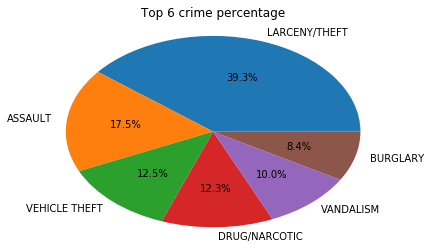

In [14]:
pie_chart = top6_df['Category'].value_counts().plot(kind='pie', title = "Top 6 crime percentage", autopct='%1.1f%%', radius = 1.1)
pie_chart.set_ylabel('')
pie_chart

<p> LARCENY/THEFT has the highest percentages (40%) among all the crimes. Therefore, we will focus on it in the machine learning and hypothesis testing part of this tutorial and see if we could grasp its pattern across different time and location. Then we can come up with some solutions to address LARCENY/THEFT problem. 

<h2> Data Analysis</h2>
<p> We may now begin our analysis. This section is dedicated to analyzing the time factor of the above crime categories. First, let's graph these top 6 crimes by their changes over the years.

In [15]:
count_crime = top6_df.groupby(['Year', 'Category']).size()
top6_year_df = count_crime.to_frame(name = "Freq").reset_index()
display(top6_year_df.head())

,Year,Category,Freq
0,2003,ASSAULT,641
1,2003,BURGLARY,292
2,2003,DRUG/NARCOTIC,471
3,2003,LARCENY/THEFT,1312
4,2003,VANDALISM,319


<p> This part is a bit tricky. If we want analyze crime frequency change over time, we want each year's each of the top 6 crime's frequency. So we call <a href = "https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.groupby.html">groupby()</a> function to group two varaible: Year and Category. It will return the combination of each year and each of the top 6 crime. How do we count the occurrences? The size of each crime group within each year will give you the occurrence. We then convert it to a panda dataframe by using .to_frame function and reset the index to 0. We can now graph it in using <a href = "https://seaborn.pydata.org/generated/seaborn.lineplot.html">seaborn.lineplot</a>.


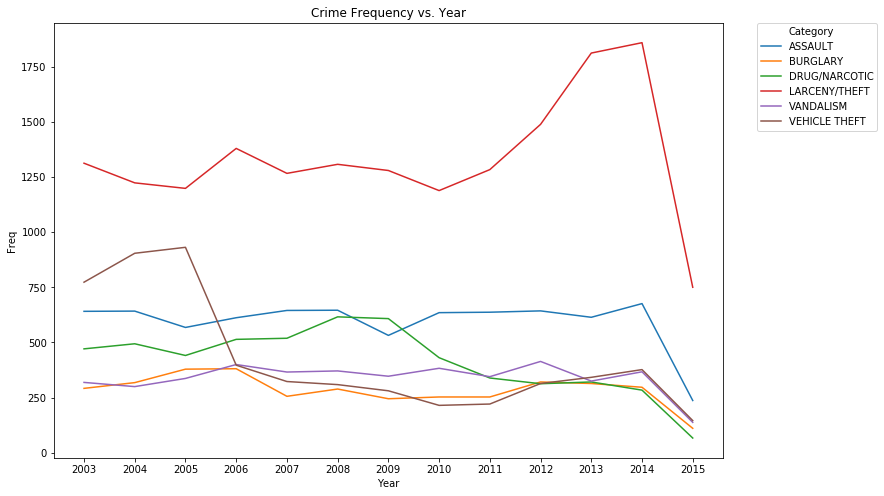

In [18]:
plt.subplots(figsize=(12,8)) # change our graph dimension
ax = sns.lineplot(x="Year", y="Freq", hue = "Category", data= top6_year_df).set_title("Crime Frequency vs. Year")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.) # change our legend position
plt.show()

<p> Now we have the Crim Frequency vs. Year graph for our top 6 crimes. We can see LARCENY/THEFT has consistantly been the most common crime. VEHICLE THEFT starts off very high but suddenly dropped in 2006. The most recent data from 2014-2015 shows all the crime has a significant decrease. This is interesting and we want to simulate its regression later. Let's do the same for Month, Day and Hour:

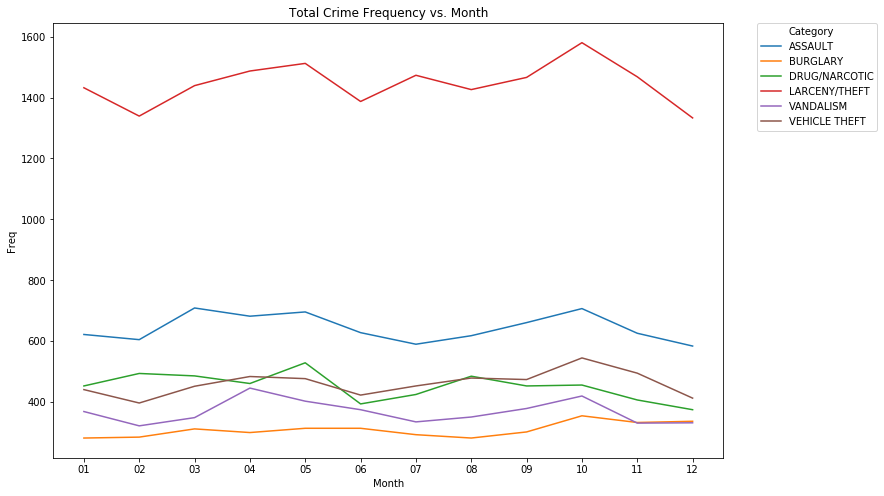

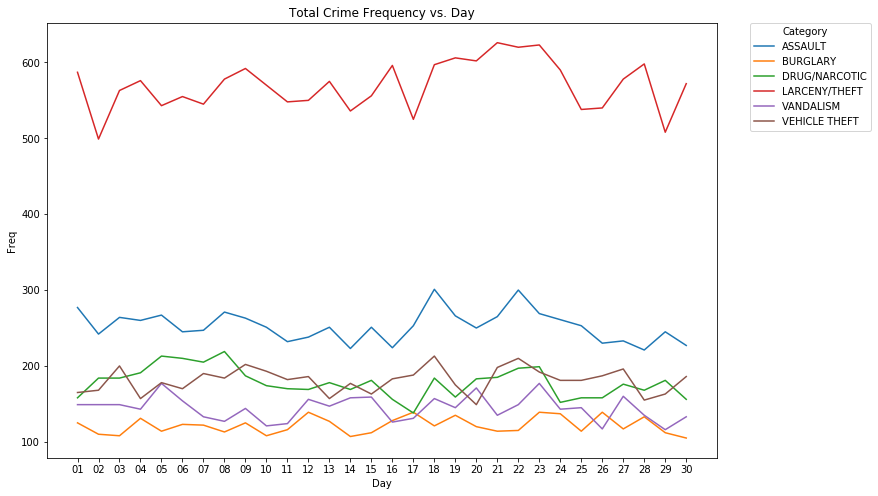

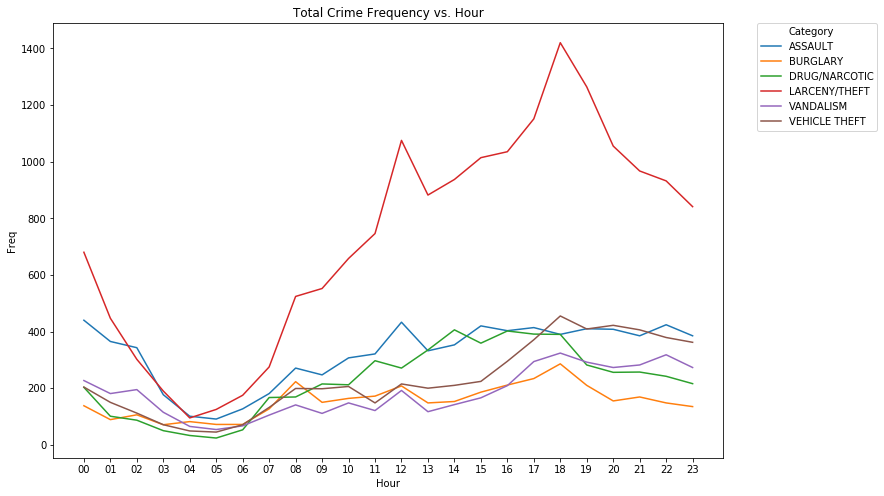

In [116]:
# Groupby Month and Category
count_crime = top6_df.groupby(['Month', 'Category']).size()
top6_month_df = count_crime.to_frame(name = "Freq").reset_index()
plt.subplots(figsize=(12,8))
ax = sns.lineplot(x="Month", y="Freq", hue = "Category", data= top6_month_df).set_title("Total Crime Frequency vs. Month")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

# Groupby Day and Category
count_crime = top6_df.groupby(['Day', 'Category']).size()
top6_day_df = count_crime.to_frame(name = "Freq").reset_index()
# We want to drop the 31st day because there are less month with 31st day
# Thus creating bias when accumulating data
top6_day_df = top6_day_df[top6_day_df.Day != '31'] 
plt.subplots(figsize=(12,8))
ax = sns.lineplot(x="Day", y="Freq", hue = "Category", data= top6_day_df).set_title("Total Crime Frequency vs. Day")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
# Groupby Hour and Category
count_crime = top6_df.groupby(['Hour', 'Category']).size()
top6_hour_df = count_crime.to_frame(name = "Freq").reset_index()
plt.subplots(figsize=(12,8))
ax = sns.lineplot(x="Hour", y="Freq", hue = "Category", data= top6_hour_df).set_title("Total Crime Frequency vs. Hour")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

<p>Some observation: Crime Frequency vs. Hours is particularly interesting. It rise up starting at 6 AM and reach its peak at 6 PM, then falls afterward. This is interesting because many people thought being outside at late night would be dangerous, but clearly there are way more cirmes happens in the afternoon. Surprsingly, Crime rate remained stable when we gropup them by month and days. 

<h2>Linear Regression and Hypothesis Testing</h2>
<p> For this part, we want to use various modeling to predict future data trend using existing data. For this tutorial, we will be using linear regression. The library widely popular now is scikit-learn.
If you want to know more about linear regression and sklearn, <a href = "http://bigdata-madesimple.com/how-to-run-linear-regression-in-python-scikit-learn/">here</a> is a great tutorial.
<p> So from above graphs, LARCENY/THEFT is important to address since it is volatile and made up big portion of all crimes. So let's first look at it by year:    

,Year,Category,Freq
3,2003,LARCENY/THEFT,1312
9,2004,LARCENY/THEFT,1223
15,2005,LARCENY/THEFT,1198
21,2006,LARCENY/THEFT,1379
27,2007,LARCENY/THEFT,1266


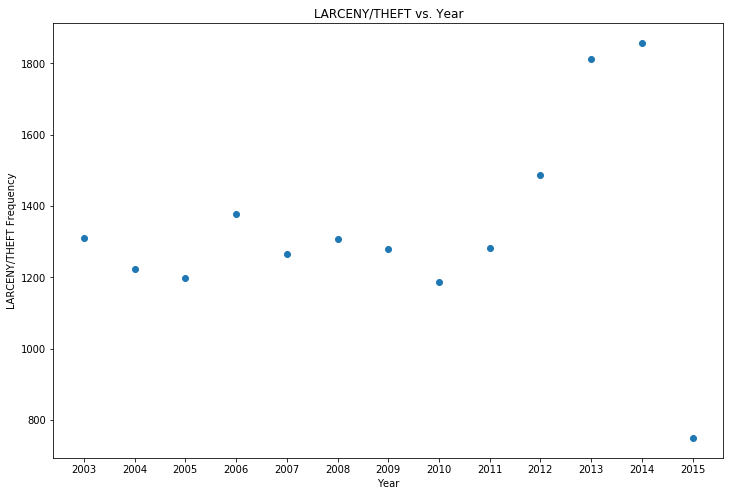

In [117]:
theft_year = top6_year_df[(top6_year_df.Category == 'LARCENY/THEFT')]
display(theft_year.head())
plt.subplots(figsize=(12,8))
plt.xlabel("Year")
plt.ylabel("LARCENY/THEFT Frequency")
plt.title("LARCENY/THEFT vs. Year")
plt.scatter(theft_year.Year, theft_year.Freq)

<p> If 2015 data is not on the graph, we would think LARCENY/THEFT rate is still surging begging at 2012. Now a linear regression would draw line such that this line has minimimum sum of Euclidean distance from the line to the data point. My prediction would be a line cut directly in the middle from about 1300 frequency on the y axis and remain relatively stable throughout the years. To garph this linear regression line, we use be using <a href = "https://scikit-learn.org/dev/modules/generated/sklearn.linear_model.LinearRegression.html">linear_model.LinearRegression()</a>


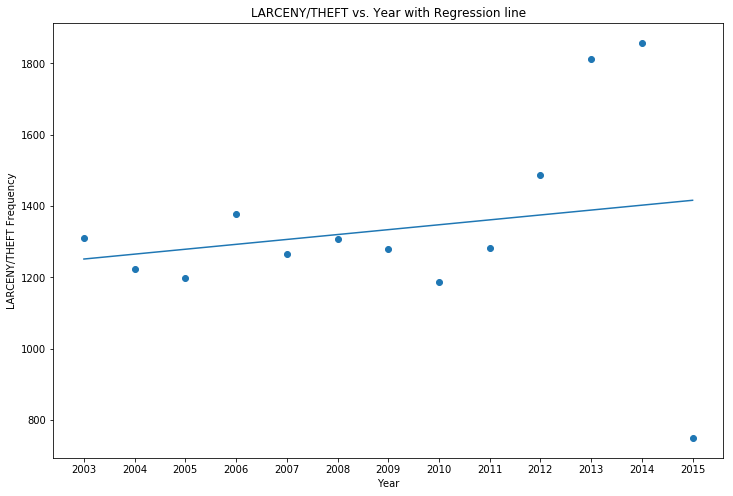

In [70]:
from sklearn.linear_model import LinearRegression
theft_year = top6_year_df[(top6_year_df.Category == 'LARCENY/THEFT')]
plt.subplots(figsize=(12,8))
plt.xlabel("Year")
plt.ylabel("LARCENY/THEFT Frequency")
plt.title("LARCENY/THEFT vs. Year with Regression line")
plt.scatter(theft_year.Year, theft_year.Freq)

clf = LinearRegression()
# we need our train year list to be a list list, thus, reshape it like [[2012], [2013], [2014]..]
year = np.array(theft_year.Year).reshape(-1, 1) 
clf.fit(year, theft_year.Freq)
predicted_freq = clf.predict(year)
plt.plot(theft_year.Year, predicted_freq)

<p> So now we have our regression line, but is our data well represented? In another word, would our data deviate from our regression line a lot? To answer this question, we need the coefficient of the determinant or R-squared(R^2) values. This is particularly useful when we try to interpret a scatter plot regression line.

In [59]:
print(clf.score(year,theft_year.Freq))

0.03673819269187628


<p> The R-squared data is very bad, usually it has to be above 0.5. The reason is obvious. Ever since 2012, data frequency went up really high and then suddenly dropped in 2015. This regression line had deviated too much from those data point. Thus, this regression line is not trustworthy for us to interpret and make a conclusion. If you want to learn more about R-squared data, <a href = "http://blog.minitab.com/blog/adventures-in-statistics-2/regression-analysis-how-do-i-interpret-r-squared-and-assess-the-goodness-of-fit">here</a> is very good description.
<p> Let's try it out for LARCENY/THEFT vs. Hour and see if its data is better for regression analysis. If we want to know average LARCENY/THEFT frequency at what hour in a single year, we have to divide the frequency by 13 to obtain the mean for one year's average. The reason being top6_hour_df calculated the sum of all 13 years theft frequency at different hours(group by hours and category). 

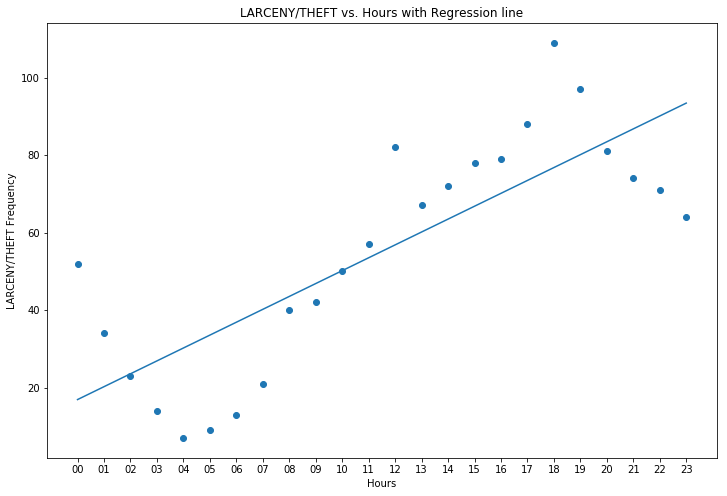

0.6258707130970935


In [107]:
theft_hour = top6_hour_df[(top6_hour_df.Category == 'LARCENY/THEFT')]
for index, row in theft_hour.iterrows():
    theft_hour.at[index, 'Freq'] = row['Freq']/13
plt.subplots(figsize=(12,8))
plt.xlabel("Hours")
plt.ylabel("LARCENY/THEFT Frequency")
plt.title("LARCENY/THEFT vs. Hours with Regression line")
plt.scatter(theft_hour.Hour, theft_hour.Freq)

clf = LinearRegression()
hour = np.array(theft_hour.Hour).reshape(-1, 1)
clf.fit(hour, theft_hour.Freq)
predicted_freq = clf.predict(hour)
plt.plot(theft_hour.Hour, predicted_freq)
plt.show()
print(clf.score(hour,theft_hour.Freq))

<p> This time our R-squared data is good! But can we do better? Observe the points together looks like a y = x^3 graph but goes diaganoly. What we need is a polynomial regression line with a degree of 3. We can use <a href = "https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.PolynomialFeatures.html">PolynomialFeatures</a> from sklearn.preprocessing. This lets us customize what degree of our regression line should be. So, let's try it out here:

before poly_transform: 
['00']
['01']
['02']
after poly_transform: 
[1. 0. 0. 0.]
[1. 1. 1. 1.]
[1. 2. 4. 8.]


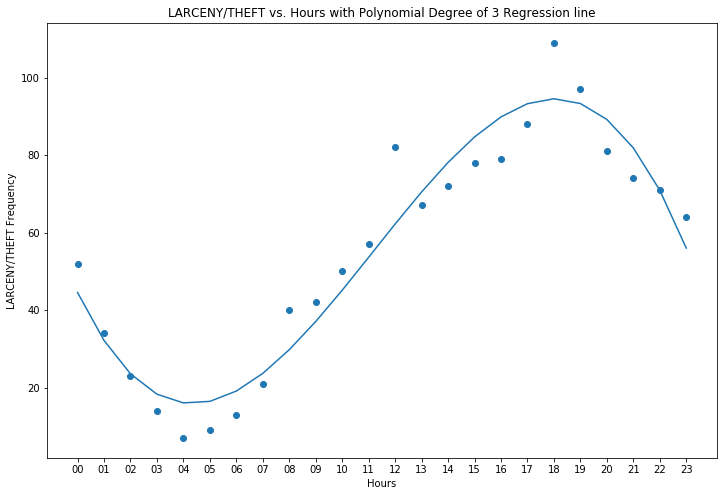

Our R-Squares is: 
0.9276489189508428


In [119]:
from sklearn.preprocessing import PolynomialFeatures
theft_hour = top6_hour_df[(top6_hour_df.Category == 'LARCENY/THEFT')]
for index, row in theft_hour.iterrows():
    theft_hour.at[index, 'Freq'] = row['Freq']/13
plt.subplots(figsize=(12,8))
plt.xlabel("Hours")
plt.ylabel("LARCENY/THEFT Frequency")
plt.title("LARCENY/THEFT vs. Hours with Polynomial Degree of 3 Regression line")
plt.scatter(theft_hour.Hour, theft_hour.Freq)

clf = LinearRegression()
poly_feat = PolynomialFeatures(degree=3)
hour = np.array(theft_hour.Hour).reshape(-1, 1)

print("before poly_transform: ")
for x in range(3): 
    print(hour[x])

hour_poly = poly_feat.fit_transform(hour)
print("after poly_transform: ")
for x in range(3): 
    print(hour_poly[x])

clf.fit(hour_poly, theft_hour.Freq)
predicted_freq = clf.predict(hour_poly)
plt.plot(theft_hour.Hour, predicted_freq)
plt.show()
print("Our R-Squares is: ")
print(clf.score(hour_poly,theft_hour.Freq))

<p> A little explanation here: We define our degree = 3 in PolynomialFeatures. Then we transform our independent variable 'hour' to the degree of 3. I printed out 'hour' and 'hour_poly' to compare. Notice we now have 4 features for each array, each one corresponding to degree 0-3(the first column is all 1 because the degree of 0 is always 1). Then our regression would try to construct a polynomial to fits these features.
<p> This time our R-squares score is 0.926, almost perfect(1 being perfect)! Now this could be a very reliable to predict our LARCENY/THEFT frequency. Let's say I want to know how many LARCENY/THEFT happening at 5 AM in the morning, we can just do:

In [115]:
display(clf.predict(poly_feat.fit_transform([[5]])))
display(clf.predict(poly_feat.fit_transform([[18]])))

array([16.44963121])

array([94.53875432])

<p> So according to our model, on average, at 5 AM there will be 16 larceny/theft crime commited but 94 at 18 PM!

<h2> Data Visualization: Location</h2><br>
<center>
<img src="financial_district.jpg" alt="Drawing" style="width: 700px;"/><br>
<b>San-Francisco Financial District</b>
</center><br>
<p> In this section we want to analyzing the location factor of the above top 6 crime categories. I use folium liberary here as I linked in the beginning of the tutorial. We first need to zoom in at San Francisco. After a google search it turns out to be: (37.7749, -122.4194)

In [28]:
crime_map = folium.Map(location=[37.7749, -122.4194], zoom_start=12)
crime_map

<p> Our current top6_df has 440k data in it. It's not visually clear when we try to squeeze 440k data in this tiny area. Thus we cut it down to about 90k data to graph here. I am using .samples again and assign it top6_vis_df

In [25]:
top6_vis_df = top6_df.sample(frac = 0.2)
display(top6_vis_df.head())
display(top6_vis_df.size)

,Dates,Category,DayOfWeek,X,Y,Year,Month,Day,Hour,Minute
130488,2013-08-20 23:00:00,LARCENY/THEFT,Tuesday,-122.409804,37.790929,2013,08,20,23,00
518623,2008-01-22 17:50:00,ASSAULT,Tuesday,-122.417393,37.790974,2008,01,22,17,50
21603,2015-02-02 11:00:00,LARCENY/THEFT,Monday,-122.392217,37.721560,2015,02,02,11,00
703056,2005-05-30 08:30:00,VEHICLE THEFT,Monday,-122.404440,37.777058,2005,05,30,08,30
93024,2014-02-18 19:00:00,VANDALISM,Tuesday,-122.434294,37.774475,2014,02,18,19,00


88550

<p>Now we just need to step through our datafarme to graph each crime data based on their location. Remember I preserved the X and Y column? We can just directly use it to graph it on our map. For each of the crime category, we will be assign a different <a href = "https://www.google.com/search?q=hex+color&rlz=1C5CHFA_enUS760US760&oq=hex+color&aqs=chrome.0.69i59j0l5.862j0j7&sourceid=chrome&ie=UTF-8">hex color code</a> to it. Here I am using folium.Circle to graph our data, you could also assign a popup variable that contains an extra description for each data point.

In [31]:
for index, row in top6_vis_df.iterrows():
    if(row['Category'] == 'LARCENY/THEFT' ):
        folium.Circle(radius=50, location=[row['Y'], row['X']], color='#262121', 
                      popup='LARCENY/THEFT', fill=True,).add_to(crime_map)
        
    elif(row['Category'] == 'BURGLARY'):
        folium.Circle(radius=50, location=[row['Y'], row['X']], color='#ff0c0c',
                      popup='BURGLARY', fill=True,).add_to(crime_map)
        
    elif(row['Category'] == 'DRUG/NARCOTIC'):
        folium.Circle(radius=50, location=[row['Y'], row['X']], color='#ffe100',
                      popup='DRUG/NARCOTIC', fill=True,).add_to(crime_map)
        
    elif(row['Category'] == 'ASSAULT'):
        folium.Circle(radius=50, location=[row['Y'], row['X']], color='#00ff33',
                      popup='ASSAULT', fill=True,).add_to(crime_map)
        
    elif(row['Category'] == 'VANDALISM'):
        folium.Circle(radius=50, location=[row['Y'], row['X']], color='#0061ff',
                      popup='VANDALISM', fill=True,).add_to(crime_map)
    else:
        folium.Circle(radius=50, location=[row['Y'], row['X']], color='#f702eb',
                      popup='VEHICLE THEFT', fill=True,).add_to(crime_map)
crime_map

<p> Here are some notes for our coloring: <br><br>
    <a style = "color:#262121">Black</a> - LARCENY/THEFT <br />
    <a style = "color:#ff0c0c">Red</a> - BURGLARY <br />
    <a style = "color:#ffe100">Yellow</a> - DRUG/NARCOTIC <br />
    <a style = "color:#00ff33">Green</a> - ASSAULT <br />
    <a style = "color:#0061ff">Blue</a> - VANDALISM <br />
    <a style = "color:#f702eb">Pink</a> - VEHICLE THEFT <br />
    

<p>By looking at the graph, we can make some conclusion. We can compare it with the empty map we graphed earlier<br />
    <ol>
        <li> There was much more LARCENY/THEFT and VEHICLE THEFT in the North East/Downtown area. Specifically, most surrounded Bush Street.
        <li> In the center of Bush Street, we can see it piled with filled with many DRUG/NARCOTIC and ASSULT crime.
        <li> In the South East Stony Hill Area, we can see a cluster of DRUG/NARCOTIC and ASSULT crime. However, It does not have many LARCENY/THEFT crime.
        <li> Other area seems "safer" compared with downtown, the crime event density is much lower, especially in the South West living area.

<hr>
<center><h1>Policy Decisions and Conclusion</h1></center>

<p> Let's summarize what we did in this tutorial:
<p> First, we change and wrangled our data, extract the information we need and drop unnecessary column and rows. Second, we try to group our crime category and see what kinda of crimes happened the most. We found out its larceny/theft.
<p> Then, we plot it against year, month, day and hours. We found out that in particular crime changes drastically during different year and hours. 
<p> We then we try to perform a linear regression analysis on the most frequent crime, larceny/theft, to interpret and predict our data. Part of data science is to reject our hypothesis. We thought our linear regression would represent the underlying data well, however, R-squared data told us otherwise. We did, however, our linear regression's turn out to be good(with an acceptable R-square) when analyzing larceny/theft frequency vs. hours graph. Moreover, we decide if we can simulate a polynomial fit line with a degree of 3. It was successful and our R-square is nearly 1, meaning we can perform reliable prediction/estimate using this polynomial regression line. 
    
<p> For analyzing location, we use folium to help us graph circle points directly on the map. With high contract colors we chose, we can easily see how each kind of crime changes over different locations.
    
<p> So what we can do now is try to is synthesize everything we did and make some suggestion and policy decision. This is really opened and real-world drove. Here are a few I believe to be important:
    <ol>
       <li>Add more police force in the North-East downtown area. It has the highest crime density. This could be progressive, starting from 9 o' clock in the morning to 18 pm in the evening, since the crime rate surges during this time.
       </li>
       <li>I am actually glad my linear regression line failed to represent each year's crime data. Why? if it succeeds, it means that San-Francisco crime is still slowly going up. One reason it failed is that in the year 2015 a significant drop in the crime rate that really change the pattern. It is very likely it was caused by artificial factors like police department taking on actions or macro political policies. So they should keep doing what they were doing in 2015.
       </li>
       <li>
           San-Franciso's crimes are not life-threatening. Most of the case people are either arrested for theft or burglary. So It could be a great place to visit and not too worry about your personal safety. But If you are touring San Francisco downtown at 6 PM in the evening, you should probably hold on to your purse/wallets. 
       </li>
    </ol>